## Copyright 2023 Google LLC

In [ ]:
# Copyright 2023 Google LLC
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#      http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# StyleAligned over SDXL from input image

#### Model Load 

In [ ]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "GPU-48d0547b-e505-7f76-7741-a012f5c16f7a"
from diffusers import StableDiffusionXLPipeline, DDIMScheduler
import torch
import mediapy
import sa_handler
import math


scheduler = DDIMScheduler(
    beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear",
    clip_sample=False, set_alpha_to_one=False)

pipeline = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, variant="fp16",
    use_safetensors=True,
    scheduler=scheduler
).to("cuda")


WARNING[XFORMERS]: xFormers can't load C++/CUDA extensions. xFormers was built for:
    PyTorch 2.1.2+cu118 with CUDA 1108 (you have 2.1.0)
    Python  3.10.13 (you have 3.10.13)
  Please reinstall xformers (see https://github.com/facebookresearch/xformers#installing-xformers)
  Memory-efficient attention, SwiGLU, sparse and more won't be available.
  Set XFORMERS_MORE_DETAILS=1 for more details


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline.load_lora_weights("/workspace/diffusers/examples/dreambooth/64rank_dreambooth_output/blue_illu_5e-5_NoTE_1000steps_long_prompt", weight_name="pytorch_lora_weights.safetensors", adapter_name="blue_illu")

#### Ref image load and inversion

100%|██████████| 30/30 [00:03<00:00,  7.63it/s]


input reference image

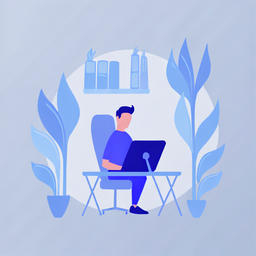

In [3]:
# DDIM inversion

from diffusers.utils import load_image
import inversion
import numpy as np

#src_prompt = 'a matt black sculpture of gorilla face'
#image_path = './image_folder/matt_black_sculpture_folder/matt.jpg'

src_prompt = 'a man working on a laptop in flat cartoon illustration style'
#image_path = './image_folder/watermelon_3d_folder/watermelon_3d.jpg'
image_path = './blue_illu_man.png'
num_inference_steps = 30
x0 = np.array(load_image(image_path).resize((1024, 1024)))
zts = inversion.ddim_inversion(pipeline, x0, src_prompt, num_inference_steps, 2)
mediapy.show_image(x0, title="input reference image", height=256)

  0%|          | 0/30 [00:00<?, ?it/s]

a man working on a laptop in flat cartoon illustration style,a man working on a laptop in flat cartoon illustration style,a dog in flat cartoon illustration style

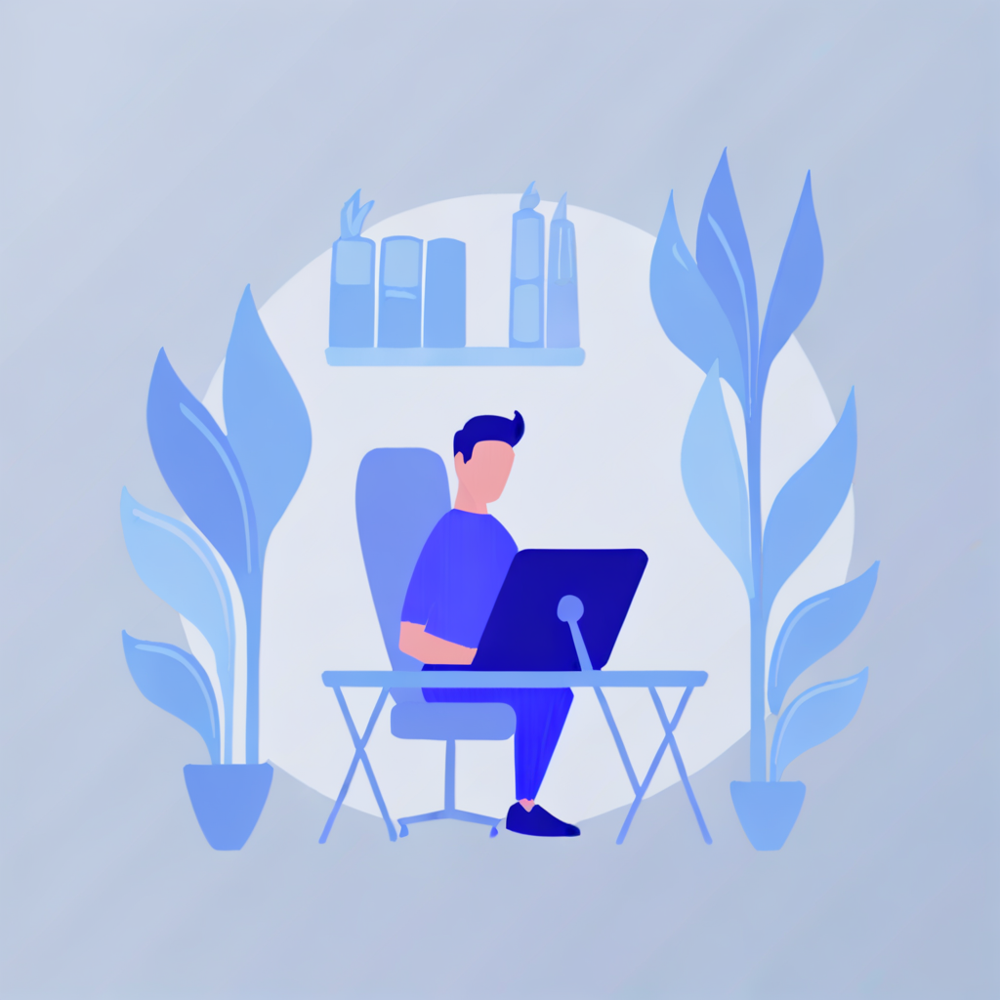
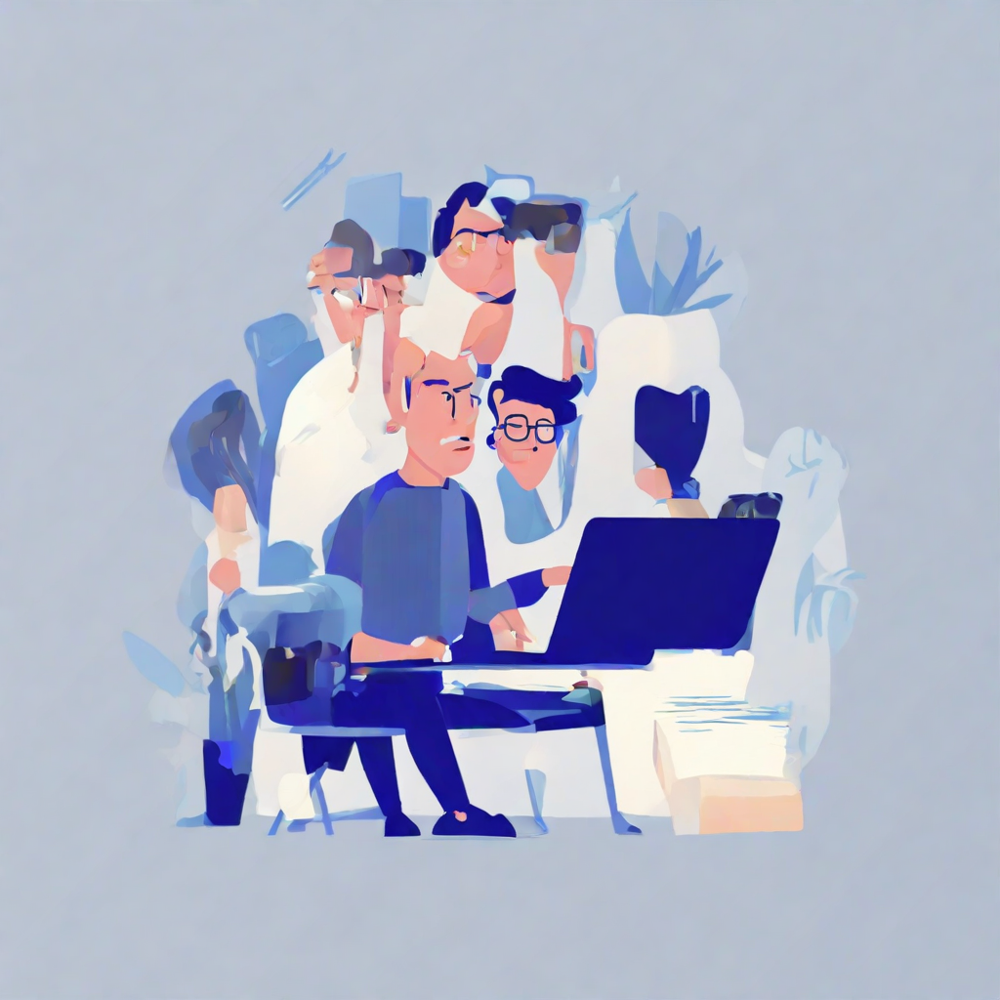
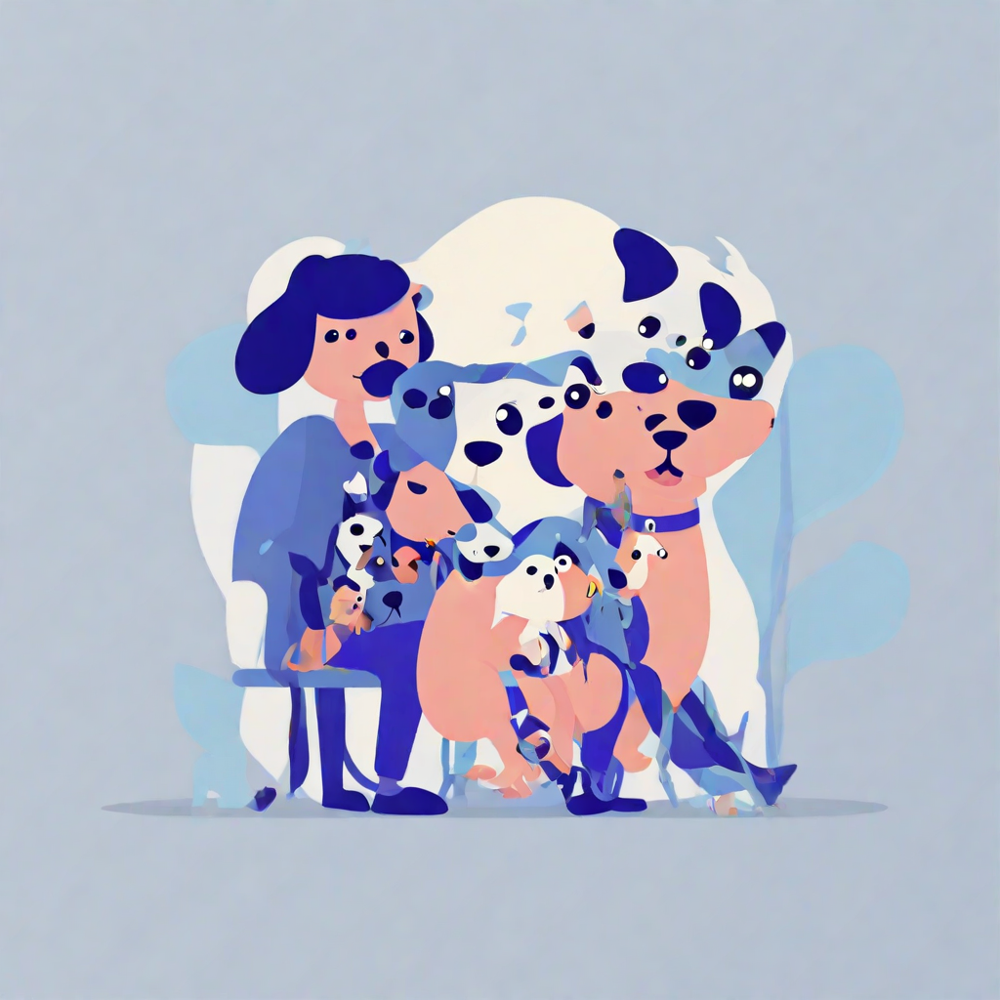

In [7]:
"""
prompts = [
    src_prompt,
    "a matt black sculpture of an old woman with earrings",
    "a matt black sculpture of an old man with eyeglasses and beard",
]
"an orange, flat cartoon illustration style",
    "an avocado, flat cartoon illustration style"
"""
prompts = [
    src_prompt,
    "a man working on a laptop in flat cartoon illustration style",
    "a dog in flat cartoon illustration style"
]

# some parameters you can adjust to control fidelity to reference
shared_score_shift = np.log(2)  # higher value induces higher fidelity, set 0 for no shift
shared_score_scale = 1.0  # higher value induces higher, set 1 for no rescale

# for very famouse images consider supressing attention to refference, here is a configuration example:
# shared_score_shift = np.log(1)
# shared_score_scale = 0.5

handler = sa_handler.Handler(pipeline)
sa_args = sa_handler.StyleAlignedArgs(
    share_group_norm=True, share_layer_norm=True, share_attention=True,
    adain_queries=True, adain_keys=True, adain_values=False,
    shared_score_shift=shared_score_shift, shared_score_scale=shared_score_scale,)
handler.register(sa_args)

zT, inversion_callback = inversion.make_inversion_callback(zts, offset=5)

g_cpu = torch.Generator(device='cpu')
g_cpu.manual_seed(111)

latents = torch.randn(len(prompts), 4, 128, 128, device='cpu', generator=g_cpu,
                      dtype=pipeline.unet.dtype,).to('cuda:0')
latents[0] = zT

images_a = pipeline(prompts, latents=latents,
                    callback_on_step_end=inversion_callback,
                    num_inference_steps=num_inference_steps, guidance_scale=10.0).images

handler.remove()
mediapy.show_images(images_a, titles=prompts)

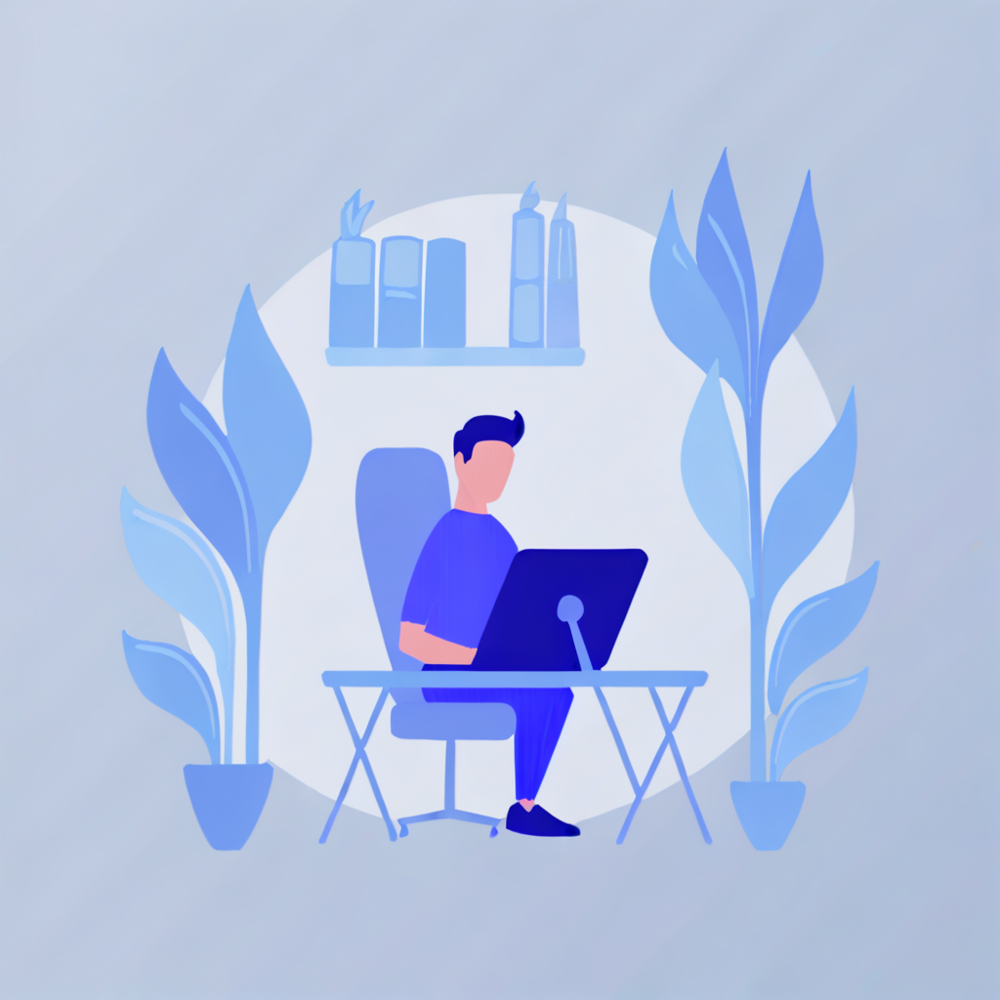

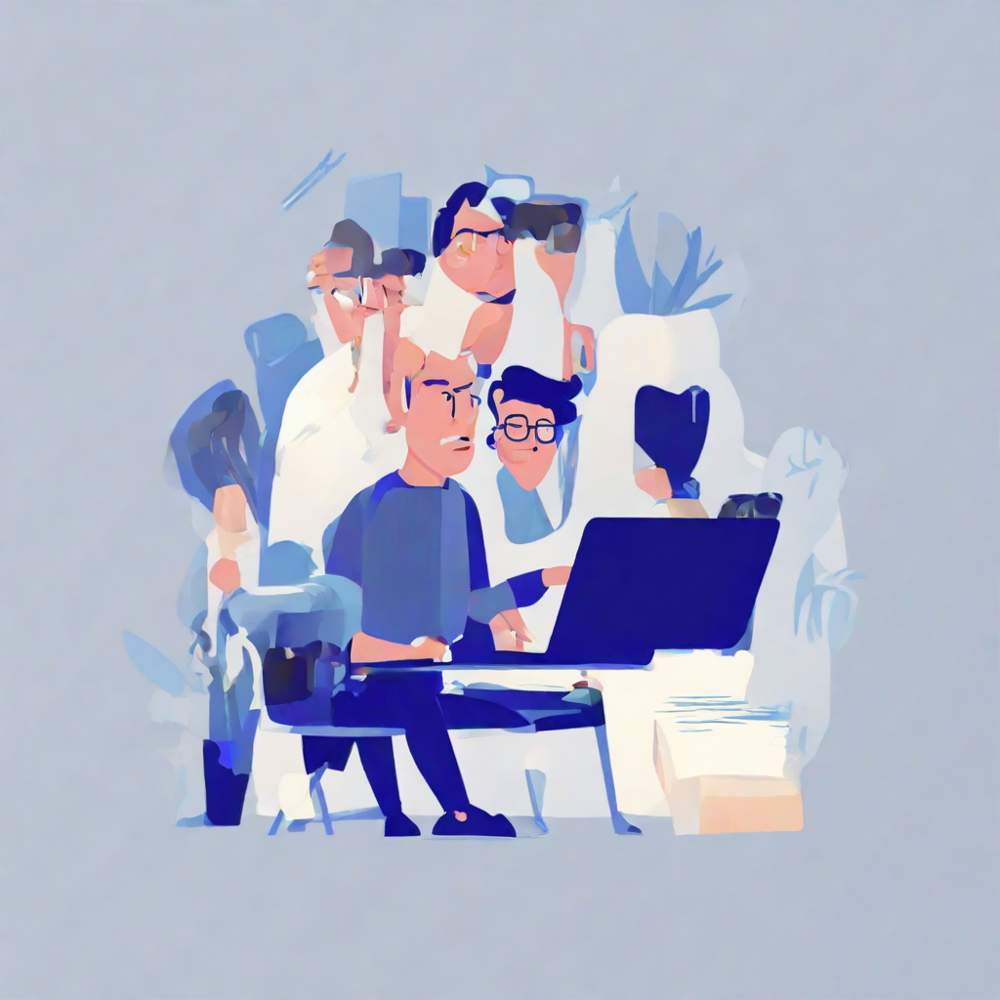

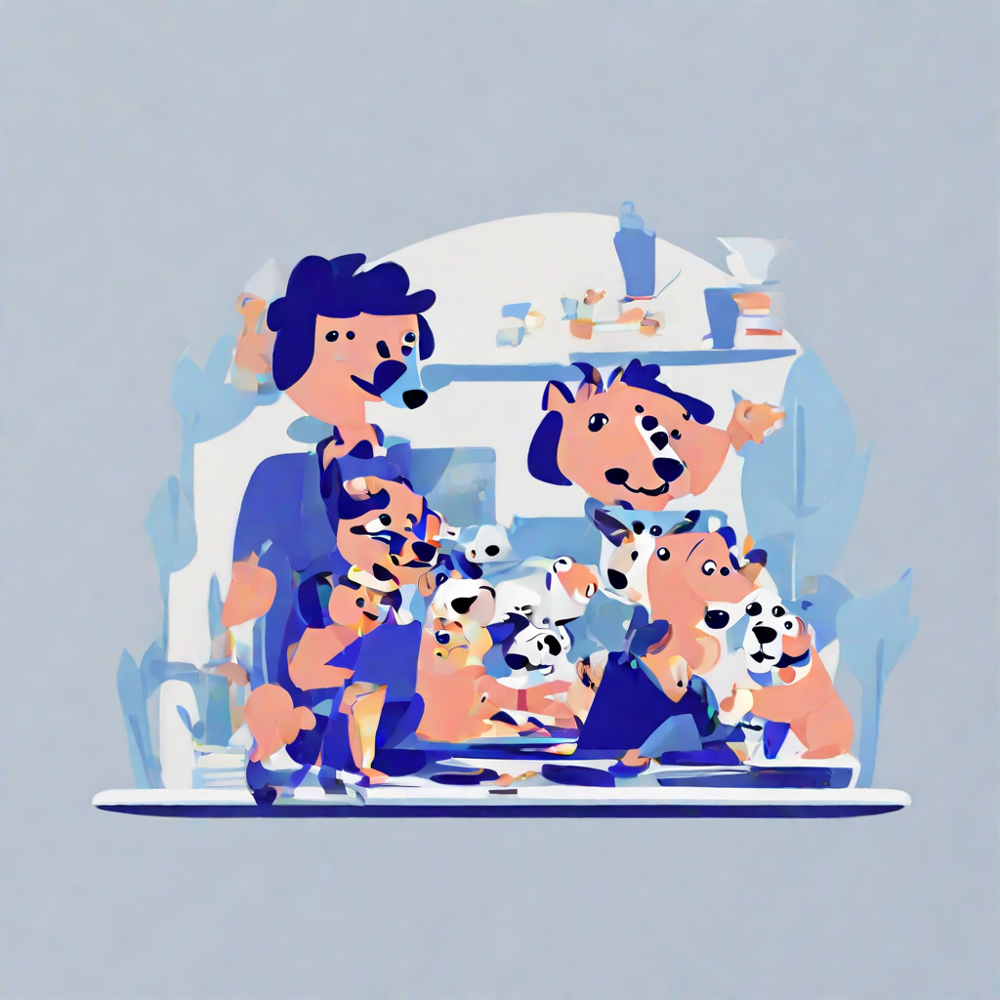

In [6]:
for img in images_a:
    img.show()

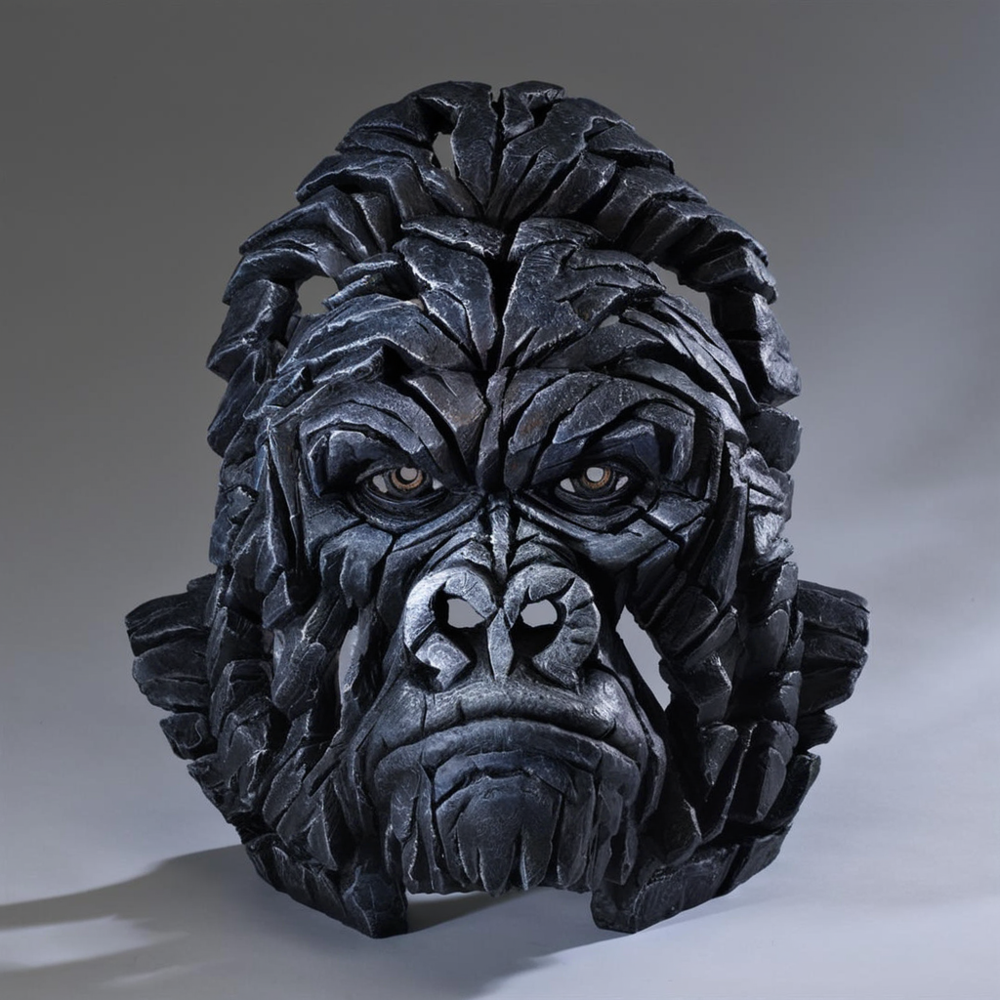

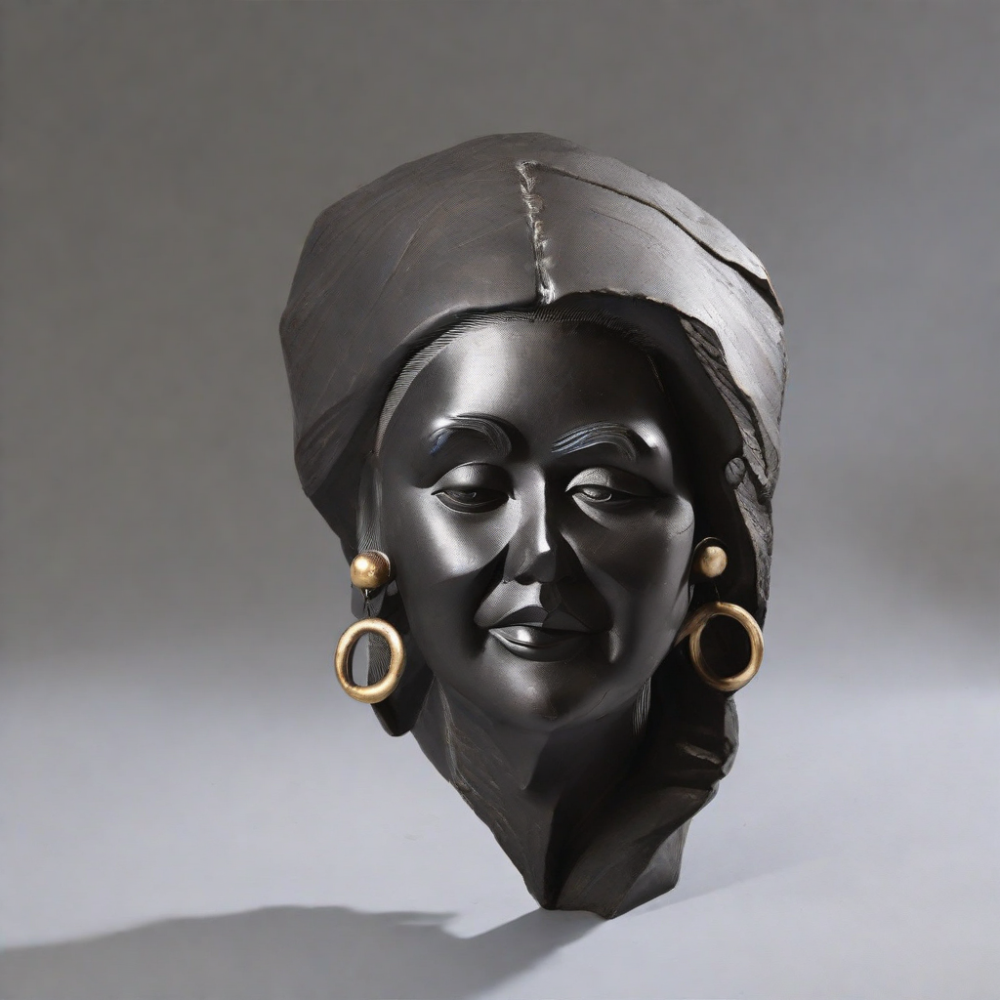

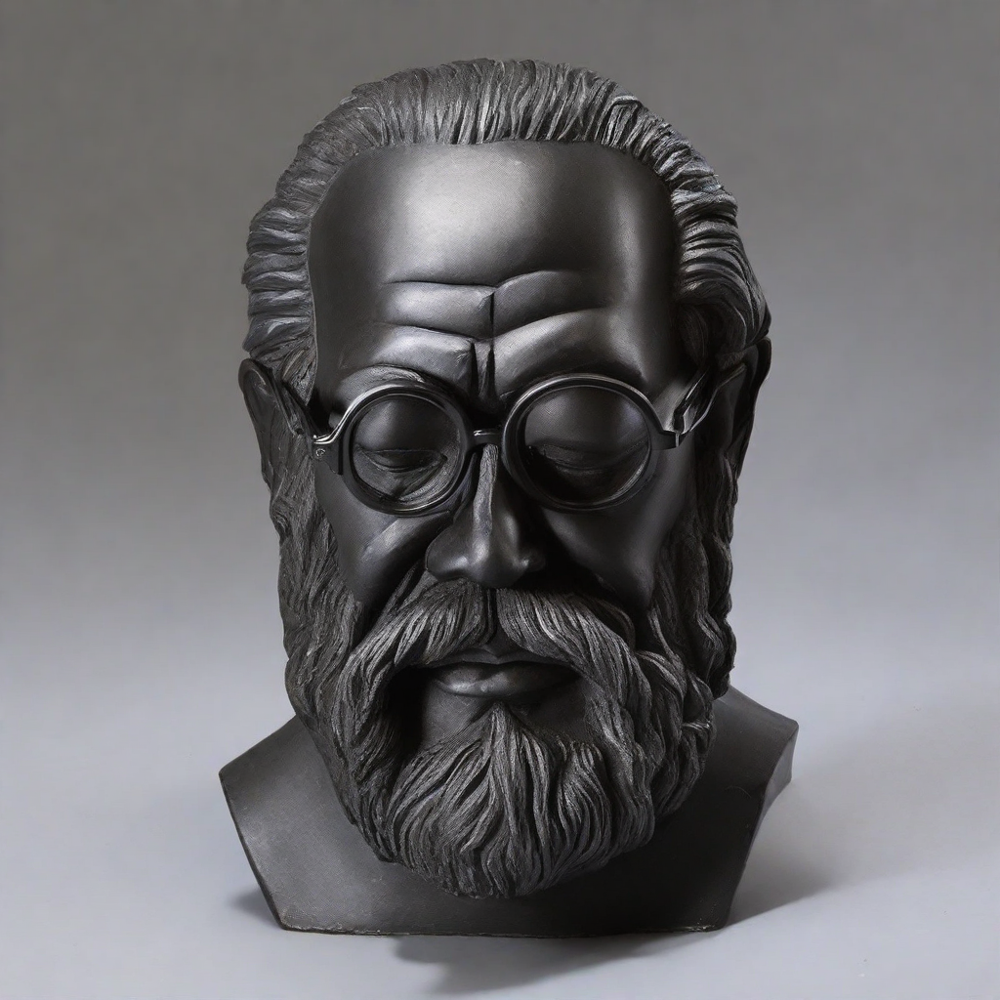

In [5]:
for img in images_a:
    img.show()

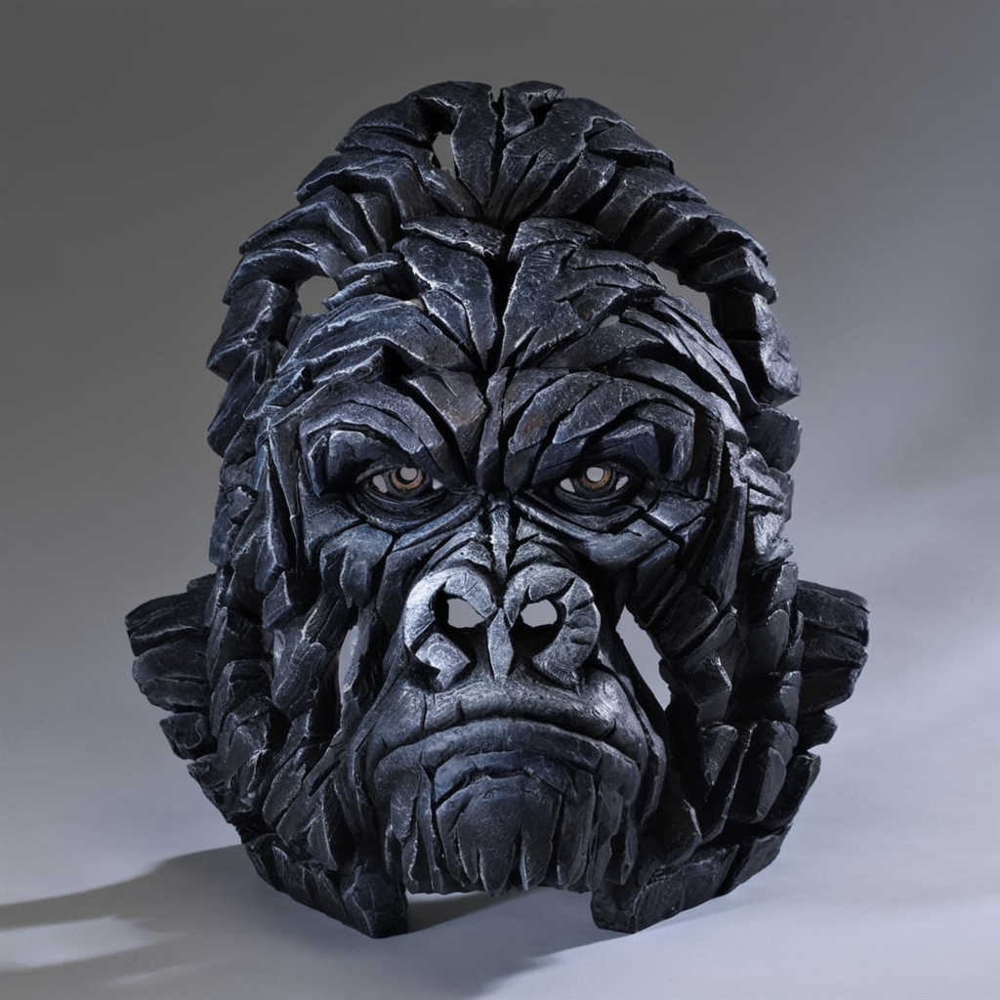

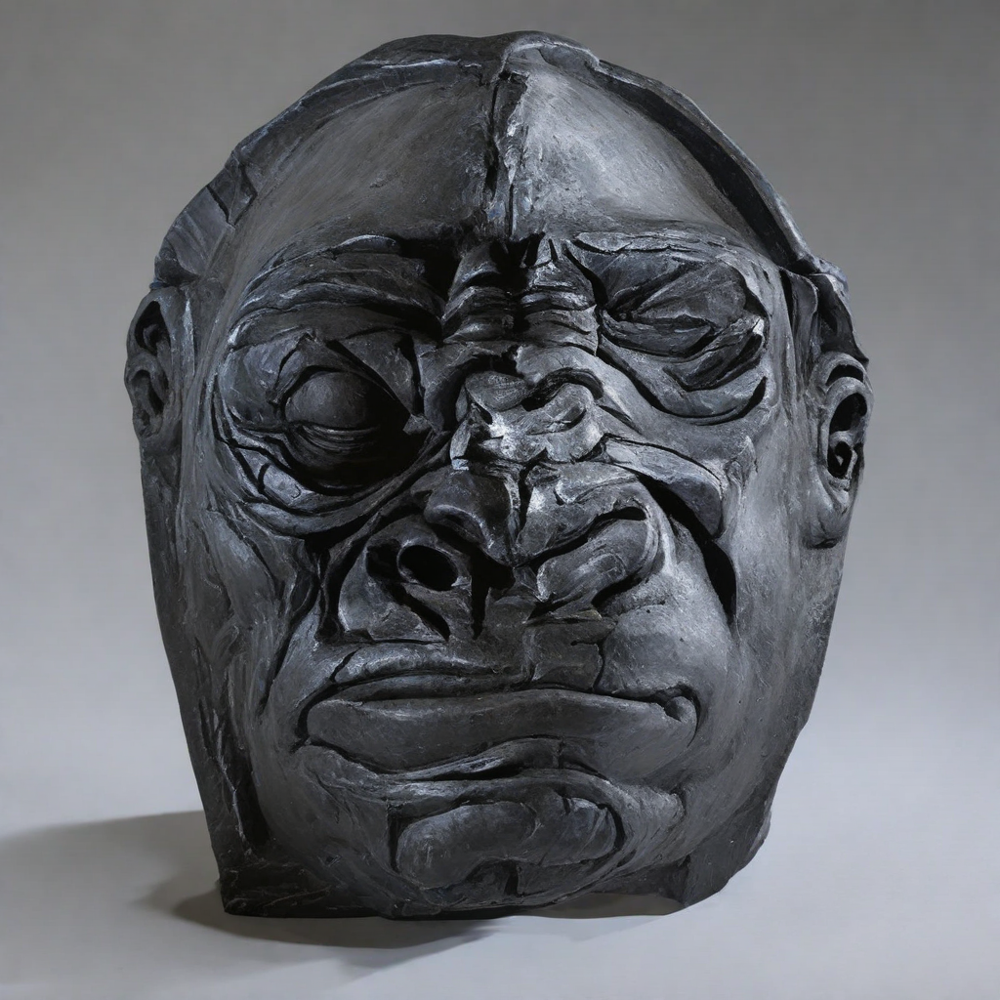

In [4]:
for img in images_a:
    img.show()

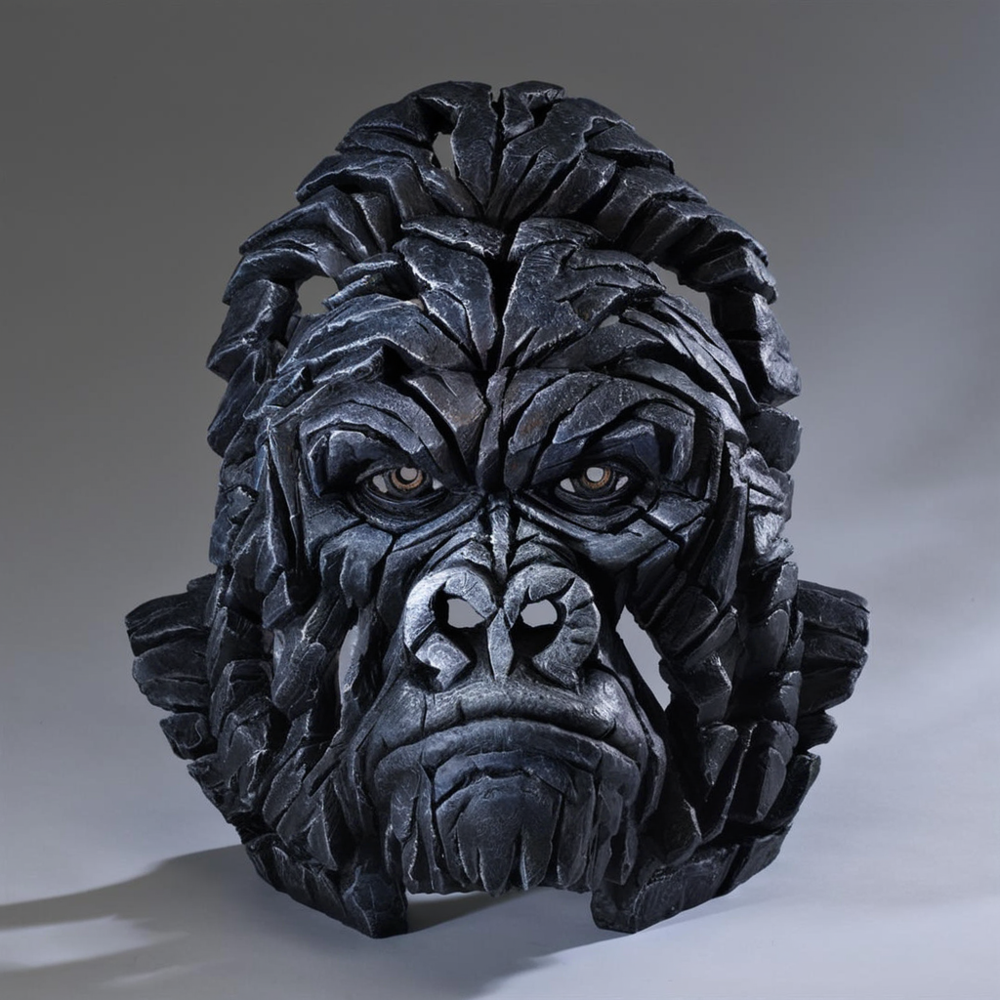

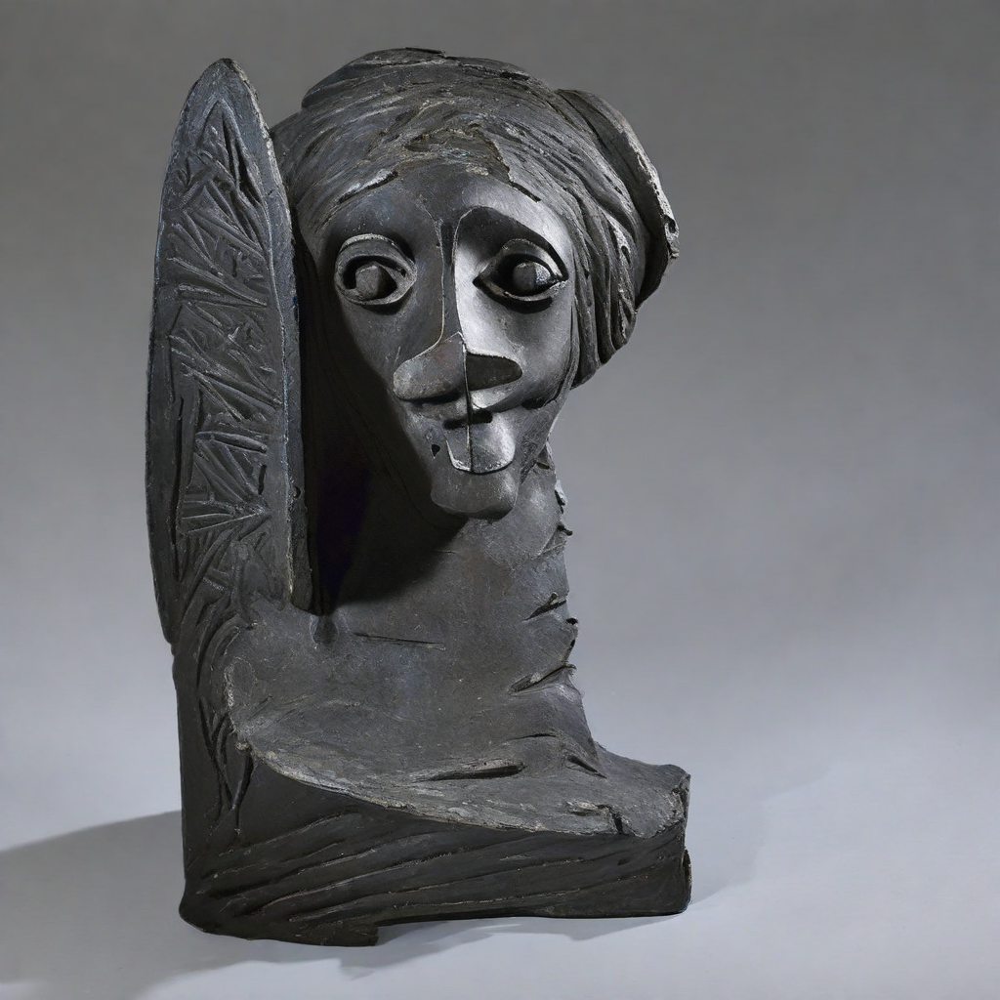

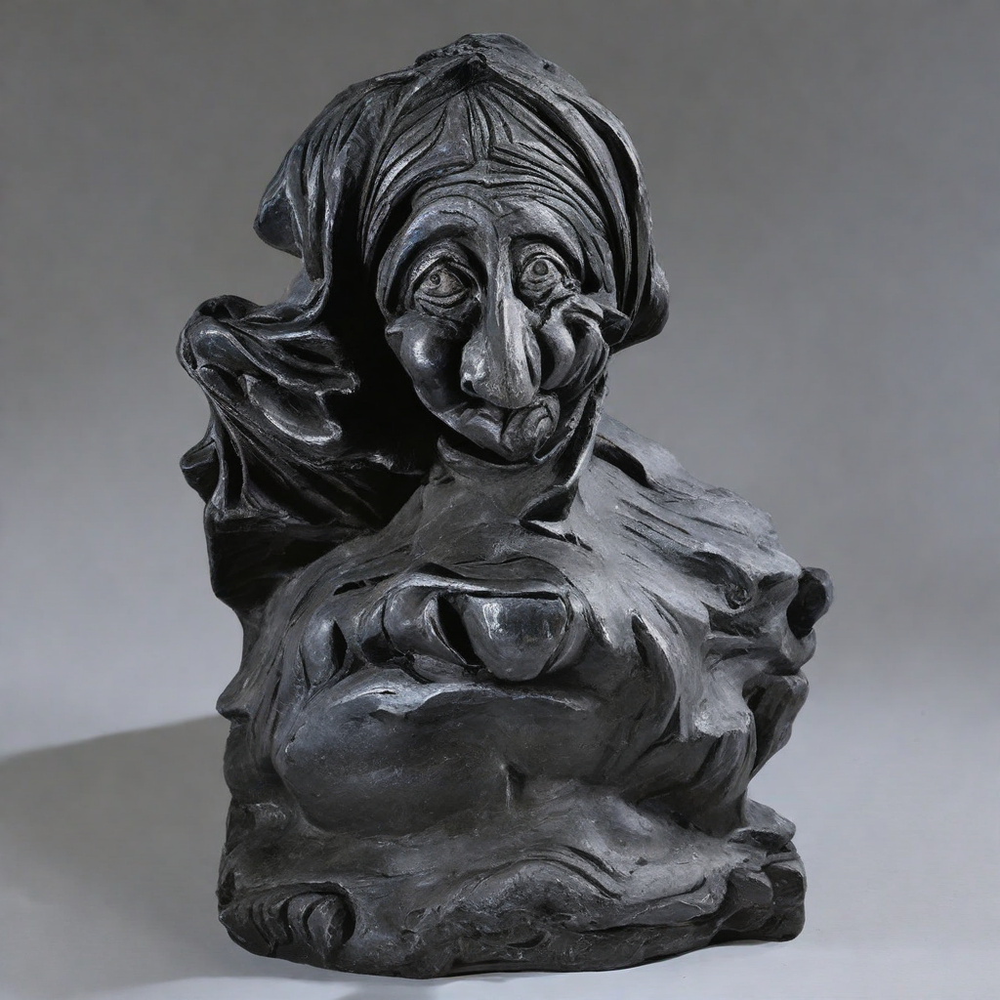

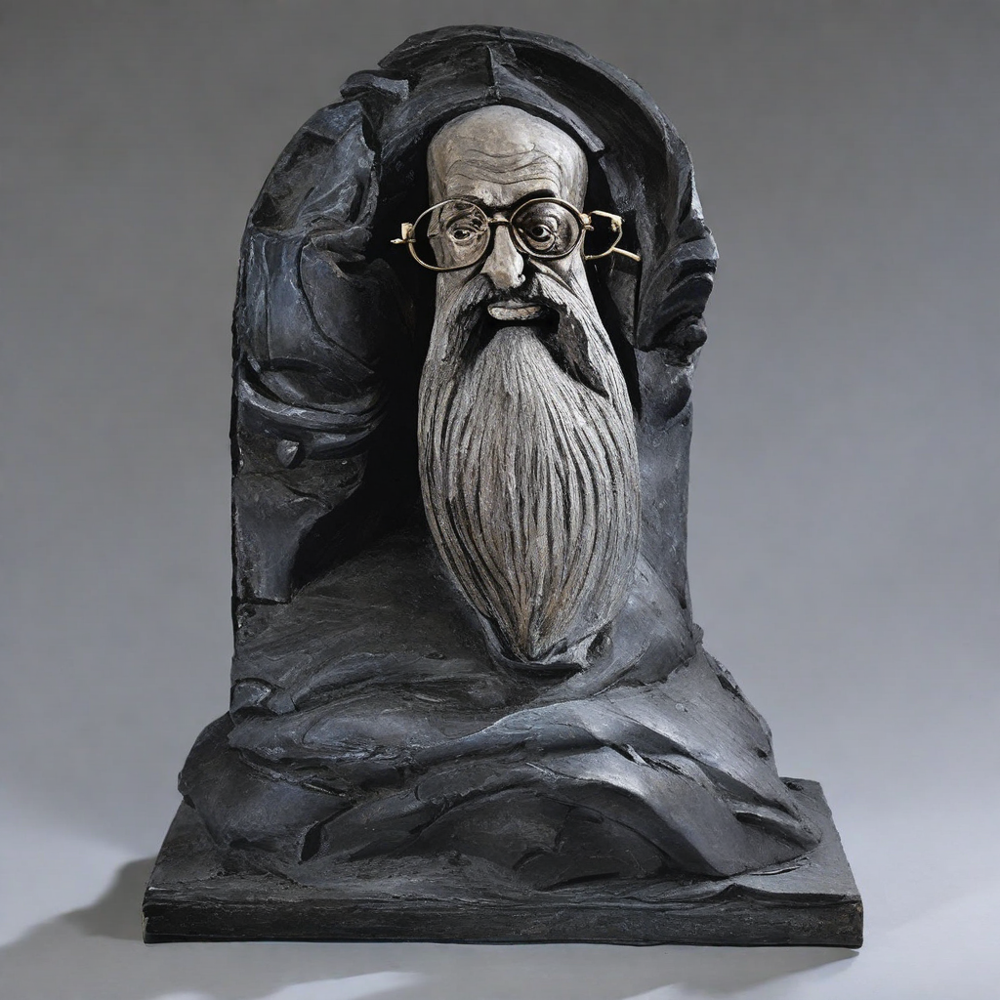

In [4]:
for img in images_a:
    img.show()